In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import nbformat
%matplotlib inline
from sklearn.preprocessing import LabelEncoder

In [6]:
train_data = pd.read_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set.csv")
test_data = pd.read_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_testing-set.csv")

In [5]:
print("Length of training set: ", len(train_data))
print("Length of testing set: ", len(test_data))

Length of training set:  175341
Length of testing set:  82332


In [31]:
train_data = train_data.drop(columns=['id'])

In [5]:
train_data.head()

,dur,proto,service,state,spkts,dpkts,sbytes,dbytes,rate,sttl,...,ct_dst_sport_ltm,ct_dst_src_ltm,is_ftp_login,ct_ftp_cmd,ct_flw_http_mthd,ct_src_ltm,ct_srv_dst,is_sm_ips_ports,attack_cat,label
0,0.121478,tcp,-,FIN,6,4,258,172,74.087490,252,...,1,1,0,0,0,1,1,0,Normal,0
1,0.649902,tcp,-,FIN,14,38,734,42014,78.473372,62,...,1,2,0,0,0,1,6,0,Normal,0
2,1.623129,tcp,-,FIN,8,16,364,13186,14.170161,62,...,1,3,0,0,0,2,6,0,Normal,0
3,1.681642,tcp,ftp,FIN,12,12,628,770,13.677108,62,...,1,3,1,1,0,2,1,0,Normal,0
4,0.449454,tcp,-,FIN,10,6,534,268,33.373826,254,...,1,40,0,0,0,2,39,0,Normal,0


In [25]:
# information about the dataset
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 175341 entries, 0 to 175340
Data columns (total 44 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   dur                175341 non-null  float64
 1   proto              175341 non-null  object 
 2   service            175341 non-null  object 
 3   state              175341 non-null  object 
 4   spkts              175341 non-null  int64  
 5   dpkts              175341 non-null  int64  
 6   sbytes             175341 non-null  int64  
 7   dbytes             175341 non-null  int64  
 8   rate               175341 non-null  float64
 9   sttl               175341 non-null  int64  
 10  dttl               175341 non-null  int64  
 11  sload              175341 non-null  float64
 12  dload              175341 non-null  float64
 13  sloss              175341 non-null  int64  
 14  dloss              175341 non-null  int64  
 15  sinpkt             175341 non-null  float64
 16  di

In [32]:
train_data['attack_cat'] = train_data.attack_cat.fillna(value='normal').apply(lambda x: x.strip().lower())

In [23]:
temp_df = train_data['attack_cat'].value_counts().rename_axis('attack_cat').reset_index(name='counts')

fig = px.bar(temp_df, x="attack_cat", y="counts", title="Attack class distribution")
fig.show()

In [12]:
fig = px.pie(train_data.attack_cat, values=train_data.attack_cat.value_counts().values, names=train_data.attack_cat.value_counts().index)
fig.show()

In [24]:
temp_df = train_data['label'].value_counts().rename_axis('label').reset_index(name='counts')

fig = px.bar(temp_df, x="label", y="counts", title="Attack records distribution")
fig.show()

In [8]:
train_data.isnull().sum()

dur                  0
proto                0
service              0
state                0
spkts                0
dpkts                0
sbytes               0
dbytes               0
rate                 0
sttl                 0
dttl                 0
sload                0
dload                0
sloss                0
dloss                0
sinpkt               0
dinpkt               0
sjit                 0
djit                 0
swin                 0
stcpb                0
dtcpb                0
dwin                 0
tcprtt               0
synack               0
ackdat               0
smean                0
dmean                0
trans_depth          0
response_body_len    0
ct_srv_src           0
ct_state_ttl         0
ct_dst_ltm           0
ct_src_dport_ltm     0
ct_dst_sport_ltm     0
ct_dst_src_ltm       0
is_ftp_login         0
ct_ftp_cmd           0
ct_flw_http_mthd     0
ct_src_ltm           0
ct_srv_dst           0
is_sm_ips_ports      0
attack_cat           0
label      

In [10]:
train_data['is_ftp_login'].value_counts()

is_ftp_login
0    172774
1      2545
4        16
2         6
Name: count, dtype: int64

In [33]:
train_data['is_ftp_login'] = np.where(train_data['is_ftp_login']>1, 1, train_data['is_ftp_login'])

In [12]:
train_data['is_ftp_login'].value_counts()

is_ftp_login
0    172774
1      2567
Name: count, dtype: int64

In [6]:
train_data.select_dtypes(exclude=np.number).columns

Index(['proto', 'service', 'state', 'attack_cat'], dtype='object')

In [13]:
train_data['service'].value_counts()

service
-           94168
dns         47294
http        18724
smtp         5058
ftp-data     3995
ftp          3428
ssh          1302
pop3         1105
dhcp           94
snmp           80
ssl            56
irc            25
radius         12
Name: count, dtype: int64

In [34]:
train_data['service'] = train_data['service'].apply(lambda x:"None" if x=="-" else x)

In [36]:
# Label ecoder to convert categorical data to numerical data
for col in ['proto', 'service', 'state']:
    le = LabelEncoder()
    train_data[col] = le.fit_transform(train_data[col])

In [37]:
X = train_data.drop('attack_cat', axis=1)
y = train_data['attack_cat']
corr_matrix = X.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Find index of feature columns with correlation greater than 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]
X.drop(columns=to_drop, inplace=True)

In [38]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
# X = train_data.drop('attack_cat', axis=1)
# y = train_data['attack_cat']

# Standardize the features
X_scaled = MinMaxScaler().fit_transform(X)

# Apply PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_scaled)

# Create a DataFrame with PCA results
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Target'] = y

import plotly.express as px
fig = px.scatter(pca_df, x="PC1", y="PC2", color="Target")
fig.show()

In [23]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42)
tsne_result = tsne.fit_transform(X_scaled)

# Create a DataFrame with t-SNE results
tsne_df = pd.DataFrame(data=tsne_result, columns=['TSNE1', 'TSNE2'])
tsne_df['Target'] = y

import plotly.express as px
fig = px.scatter(tsne_df, x="TSNE1", y="TSNE2", color="Target")
fig.show()

In [ ]:
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.linear_model import ElasticNetCV
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
import numpy as np

# Assuming df is your DataFrame with features and target variable

# Separate features and target variable
X = train_data.drop('attack_cat', axis=1)
y = train_data['attack_cat']

le = LabelEncoder()
y = le.fit_transform(y)
# X_numeric = X.select_dtypes(include=[np.number])

# Standardize the features (optional but recommended for regularization models)
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

# Set up 5-fold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Lists to store results
mse_list = []
coefficients_list = []

# Iterate through 5 folds
for train_index, test_index in kf.split(X_scaled):
    X_train, X_test = X_scaled[train_index], X_scaled[test_index]
    y_train, y_test = y[train_index], y[test_index]
    # Randomly determine alpha values within a range
    alpha_values = 10 ** np.random.uniform(-4, 2, 10)

    # Create and train ElasticNetCV model
    elastic_net_cv = ElasticNetCV(alphas=alpha_values, l1_ratio=0.5, cv=5)
    elastic_net_cv.fit(X_train, y_train)

    # Make predictions on the test set
    y_pred = elastic_net_cv.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    mse_list.append(mse)

    # Store coefficients
    coefficients_list.append(elastic_net_cv.coef_)

# Average Mean Squared Error across folds
average_mse = np.mean(mse_list)
print(f'Average Mean Squared Error: {average_mse}')

# Average coefficients across folds
average_coefficients = np.mean(coefficients_list, axis=0)
print('Average Coefficients:')
print(pd.Series(average_coefficients, index=X.columns))

In [12]:
train_data = pd.read_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set.csv")
temp_df = train_data['proto'].value_counts().rename_axis('proto').reset_index(name='counts')

fig = px.bar(temp_df, x="proto", y="counts", title="Protocol distribution")
fig.show()

temp_df = train_data['service'].value_counts().rename_axis('service').reset_index(name='counts')

fig = px.bar(temp_df, x="service", y="counts", title="Service distribution")
fig.show()

temp_df = train_data['state'].value_counts().rename_axis('state').reset_index(name='counts')

fig = px.bar(temp_df, x="state", y="counts", title="State distribution")
fig.show()

In [13]:
train_data = pd.read_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set.csv")
test_data = pd.read_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_testing-set.csv")
train_data = train_data.drop(columns=['id'])
train_data['attack_cat'] = train_data.attack_cat.fillna(value='normal').apply(lambda x: x.strip().lower())
train_data['is_ftp_login'] = np.where(train_data['is_ftp_login']>1, 1, train_data['is_ftp_login'])
train_data['service'] = train_data['service'].apply(lambda x:"None" if x=="-" else x)
# Label ecoder to convert categorical data to numerical data
for col in ['proto', 'service', 'state']:
    le = LabelEncoder()
    train_data[col] = le.fit_transform(train_data[col])
from sklearn.model_selection import train_test_split
reduced_df = pd.DataFrame()
for attack_cat in train_data.attack_cat.unique():
  temp_df = train_data[train_data['attack_cat'] == attack_cat]
  temp_X = temp_df.drop('attack_cat', axis=1)
  temp_y = temp_df['attack_cat']
  temp_X_train, temp_X_test, temp_y_train, temp_y_test = train_test_split(temp_X, temp_y, test_size=0.9, random_state=42)
  temp_reduced_df = temp_X_train
  temp_reduced_df['attack_cat'] = temp_y_train
  reduced_df = pd.concat([reduced_df, temp_reduced_df], ignore_index=True)

In [14]:
reduced_X = reduced_df.drop('attack_cat', axis=1)
reduced_y = reduced_df['attack_cat']
corr_matrix = reduced_X.corr().abs()

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Find index of feature columns with correlation greater than 0.9
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]
reduced_X.drop(columns=to_drop, inplace=True)

In [6]:
temp_df = reduced_df['attack_cat'].value_counts().rename_axis('attack_cat').reset_index(name='counts')

fig = px.bar(temp_df, x="attack_cat", y="counts", title="Attack class distribution")
fig.show()

fig = px.pie(reduced_df.attack_cat, values=reduced_df.attack_cat.value_counts().values, names=reduced_df.attack_cat.value_counts().index)
fig.show()

In [7]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
# X = train_data.drop('attack_cat', axis=1)
# y = train_data['attack_cat']

# Standardize the features
reduced_X_scaled = MinMaxScaler().fit_transform(reduced_X)

# Apply PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(reduced_X_scaled)

# Create a DataFrame with PCA results
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Target'] = reduced_y

import plotly.express as px
fig = px.scatter(pca_df, x="PC1", y="PC2", color="Target")
fig.show()

In [16]:
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
from sklearn.manifold import MDS
from sklearn.manifold import LocallyLinearEmbedding
from sklearn.manifold import TSNE
from sklearn.metrics import pairwise_distances
from sklearn.decomposition import KernelPCA
from umap import UMAP


# Separate features and target variable
# X = train_data.drop('attack_cat', axis=1)
# y = train_data['attack_cat']

# Standardize the features
X_scaled = MinMaxScaler().fit_transform(reduced_X)

# Non-linear dimensionality reduction techniques
methods = [
    # MDS(n_components=2, random_state=42, dissimilarity='euclidean'),
    LocallyLinearEmbedding(n_components=2, eigen_solver='dense', random_state=42),
    # UMAP(n_components=2)
    # TSNE(n_components=2, random_state=42),
]

charts = []
for method in methods:
    # Apply dimensionality reduction
    if type(method) == MDS:
        # MDS requires a distance matrix
        distance_matrix = pairwise_distances(X_scaled)
        components = method.fit_transform(distance_matrix)
    else:
        components = method.fit_transform(X_scaled)

    # Create a DataFrame with the components
    df_reduced = pd.DataFrame(components, columns=[f'Component{i+1}' for i in range(components.shape[1])])
    df_reduced['Target'] = reduced_y
    df_reduced.to_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set_mds.csv")

    # Create a scatter plot
    scatter = px.scatter(df_reduced, x='Component1', y='Component2', color='Target', title=type(method).__name__)
    charts.append(scatter)

# Display comparative charts
for chart in charts:
    chart.show()


c:\Users\rvkau\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\manifold\_mds.py:601: UserWarning:

The MDS API has changed. ``fit`` now constructs an dissimilarity matrix from data. To use a custom dissimilarity matrix, set ``dissimilarity='precomputed'``.

c:\Users\rvkau\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\manifold\_mds.py:298: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



c:\Users\rvkau\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\rvkau\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\manifold\_mds.py:298: FutureWarning:

The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.



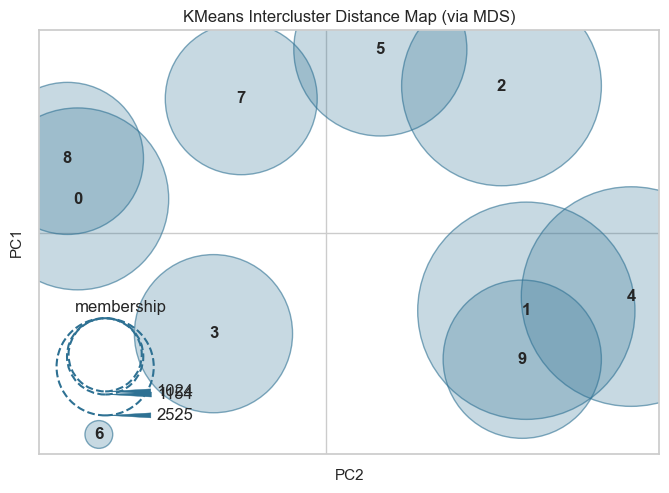

<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from yellowbrick.cluster import InterclusterDistance

# Apply K-means clustering
kmeans = KMeans(n_clusters=10, random_state=42)
labels = kmeans.fit_predict(reduced_X_scaled)

# Visualize inter-cluster distances
visualizer = InterclusterDistance(kmeans)
visualizer.fit(reduced_X_scaled)
visualizer.show()

# # Optionally, you can visualize the K-means clusters
# plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=labels, cmap='viridis', edgecolors='k', alpha=0.7)
# plt.title('K-means Clusters')
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
# plt.show()

In [ ]:
# import pandas as pd
# from sklearn.preprocessing import Normalizer, MinMaxScaler, RobustScaler, StandardScaler, QuantileTransformer, PowerTransformer
# from scipy.spatial.distance import mahalanobis
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Assuming you have a DataFrame named 'df' with numerical features and a target column 'target_class'

# # List of scaler names and corresponding scaler instances
# scalers = {
#     'Data Normalizer': Normalizer(),
#     'Min-Max Scaler': MinMaxScaler(),
#     'Robust Scaler': RobustScaler(),
#     'Standard Scaler': StandardScaler(),
#     'Quantile Transformer': QuantileTransformer(),
#     'Power Transformer': PowerTransformer()
# }
# reg_term = 1e-5
# # Function to calculate Mahalanobis distance between class centroids
# def mahalanobis_distance(data, scaler):
#     temp = data.drop('attack_cat',axis=1)
#     scaled_data = scaler.fit_transform(temp)
#     centroids = {}
#     classes = data['attack_cat'].unique()

#     for c in classes:
#         centroids[c] = scaled_data[data['attack_cat'] == c].mean(axis=0)

#     print(centroids)

#     distance_matrix = pd.DataFrame(index=classes, columns=classes)

#     for c1 in classes:
#         for c2 in classes:
#             cov_matrix = np.cov(scaled_data[data['attack_cat'] == c1].T)
#             cov_matrix += reg_term * np.identity(cov_matrix.shape[0])  # Add regularization term
#             cov_inv = np.linalg.inv(cov_matrix)
#             distance_matrix.loc[c1, c2] = mahalanobis(centroids[c1], centroids[c2], cov_inv)

#     return distance_matrix

# # Function to plot heatmaps
# def plot_heatmap(data, title):
#     plt.figure(figsize=(16, 12))
#     sns.heatmap(data, annot=True, cmap="viridis", fmt='.4f', linewidths=.5)
#     plt.title(title)
#     plt.show()

# # Iterate through scalers and generate heatmaps
# for scaler_name, scaler_instance in scalers.items():
#     numerical_columns = train_data.select_dtypes(include=[np.number]).columns
#     df_scaled = train_data.copy()
#     distance_matrix_before = mahalanobis_distance(train_data, scaler_instance)

#     df_scaled[numerical_columns] = scaler_instance.fit_transform(train_data[numerical_columns])

#     distance_matrix_before = mahalanobis_distance(train_data, scaler_instance)
#     distance_matrix_after = mahalanobis_distance(df_scaled, scaler_instance)

#     # Plot heatmaps
#     plot_heatmap(distance_matrix_before, f'Mahalanobis Distance Before {scaler_name}')
#     plot_heatmap(distance_matrix_after, f'Mahalanobis Distance After {scaler_name}')


In [56]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import TruncatedSVD
X_scaled = MinMaxScaler().fit_transform(reduced_X)
# Apply SVD
svd = TruncatedSVD(n_components=2)

# Fit the TruncatedSVD model to the data
components = svd.fit_transform(X_scaled)
df_reduced = pd.DataFrame(components, columns=[f'Component{i+1}' for i in range(components.shape[1])])
df_reduced['Target'] = reduced_y
df_reduced.to_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set_svd.csv")

# # Visualize the SVD components using Plotly Express
fig = px.scatter(
    df_reduced, x='Component1', y='Component2', color='Target',
    title='SVD Dimensionality Reduction of UNSW-NB15 Dataset',
    labels={'Component1': 'SVD Component 1', 'Component2': 'SVD Component 2'}
)

# Show the plot
fig.show()


In [67]:
from sklearn.preprocessing import MinMaxScaler
from pydiffmap import diffusion_map as dm
from pydiffmap import kernel
X_scaled = MinMaxScaler().fit_transform(reduced_X)

# Apply Diffusion Mapping
n_neighbors = 30
epsilon = 0.5
kernel_object = kernel.Kernel(epsilon=epsilon, k=n_neighbors)
embedding = dm.DiffusionMap(kernel_object=kernel_object, n_evecs=2).fit_transform(X_scaled)

# Create a DataFrame with the Diffusion Mapping components
df_diffusion = pd.DataFrame(embedding, columns=[f'Component{i+1}' for i in range(embedding.shape[1])])
df_diffusion['label'] = reduced_y
df_reduced.to_csv(r"c:\Users\rvkau\Downloads\UNSW_NB15\UNSW_NB15_training-set_diffusion_mapping.csv")
# Visualize the Diffusion Mapping components using Plotly Express
fig = px.scatter(
    df_diffusion, x='Component1', y='Component2', color='label',
    title='Diffusion Mapping Dimensionality Reduction of UNSW-NB15 Dataset',
    labels={'Component1': 'Diffusion Component 1', 'Component2': 'Diffusion Component 2'},
    hover_name=df_diffusion.index  # Add index as hover information
)

# Show the plot
fig.show()